# Example 3 
## Load toy Datasets and do some basic statistics
Lets try the digits toy dataset from scikit-learn. 

In [5]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [6]:
from sklearn.datasets import load_digits
# from sklearn.model_selection import train_test_split
from pprint import pprint
import matplotlib.pyplot as plt
import math

In [7]:
df = load_digits(as_frame=True)
df_colms = df.keys()
print(df_colms)

dict_keys(['data', 'target', 'frame', 'feature_names', 'target_names', 'images', 'DESCR'])


In [8]:
data = df.data
target = df.target
targetNames = df.target_names
features = df.feature_names
DESCR = df.DESCR
frame = df.frame

In [9]:
frame.describe()

,pixel_0_0,pixel_0_1,pixel_0_2,pixel_0_3,pixel_0_4,pixel_0_5,pixel_0_6,pixel_0_7,pixel_1_0,pixel_1_1,...,pixel_6_7,pixel_7_0,pixel_7_1,pixel_7_2,pixel_7_3,pixel_7_4,pixel_7_5,pixel_7_6,pixel_7_7,target
count,1797.0,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,...,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000
mean,0.0,0.303840,5.204786,11.835838,11.848080,5.781859,1.362270,0.129661,0.005565,1.993879,...,0.206455,0.000556,0.279354,5.557596,12.089037,11.809126,6.764051,2.067891,0.364496,4.490818
std,0.0,0.907192,4.754826,4.248842,4.287388,5.666418,3.325775,1.037383,0.094222,3.196160,...,0.984401,0.023590,0.934302,5.103019,4.374694,4.933947,5.900623,4.090548,1.860122,2.865304
min,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.0,0.000000,1.000000,10.000000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,1.000000,11.000000,10.000000,0.000000,0.000000,0.000000,2.000000
50%,0.0,0.000000,4.000000,13.000000,13.000000,4.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,4.000000,13.000000,14.000000,6.000000,0.000000,0.000000,4.000000
75%,0.0,0.000000,9.000000,15.000000,15.000000,11.000000,0.000000,0.000000,0.000000,3.000000,...,0.000000,0.000000,0.000000,10.000000,16.000000,16.000000,12.000000,2.000000,0.000000,7.000000
max,0.0,8.000000,16.000000,16.000000,16.000000,16.000000,16.000000,15.000000,2.000000,16.000000,...,13.000000,1.000000,9.000000,16.000000,16.000000,16.000000,16.000000,16.000000,16.000000,9.000000


# The Middle

* Mean: Average $\mu = \sum_{i}^{n} \frac{x_{i}}{n}$
* Median: Middle. There are the same number of records before and after.
* Mode(s): Most common value(s).

In [10]:
print(f'{("Feature" + " "*30)[:31]} Mean   Sum/Size   Median      Mode(s)')
for feature in features:
    colm = data[feature]
    mode = '(' + str(colm.mode())
    mode = mode.replace('\nName', '  Name')[:mode.find("\nName")]
    mode = mode.replace('\n', ') , (') + ')'
    print(f'{(feature+" "*30)[:29]}', end=' | ')
    print(f' {round(colm.mean(), 1)}', end='  | ')
    print(f' {round(colm.sum()/colm.size, 1)}', end='   | ')
    print(f' {round(colm.median(), 1)}', end='     | ')
    print(f' {mode}')

Feature                         Mean   Sum/Size   Median      Mode(s)
pixel_0_0                     |  0.0  |  0.0   |  0.0     |  (0    0.0)
pixel_0_1                     |  0.3  |  0.3   |  0.0     |  (0    0.0)
pixel_0_2                     |  5.2  |  5.2   |  4.0     |  (0    0.0)
pixel_0_3                     |  11.8  |  11.8   |  13.0     |  (0    16.0)
pixel_0_4                     |  11.8  |  11.8   |  13.0     |  (0    16.0)
pixel_0_5                     |  5.8  |  5.8   |  4.0     |  (0    0.0)
pixel_0_6                     |  1.4  |  1.4   |  0.0     |  (0    0.0)
pixel_0_7                     |  0.1  |  0.1   |  0.0     |  (0    0.0)
pixel_1_0                     |  0.0  |  0.0   |  0.0     |  (0    0.0)
pixel_1_1                     |  2.0  |  2.0   |  0.0     |  (0    0.0)
pixel_1_2                     |  10.4  |  10.4   |  12.0     |  (0    16.0)
pixel_1_3                     |  12.0  |  12.0   |  13.0     |  (0    16.0)
pixel_1_4                     |  10.3  |  10.3   |

# Variability:

* Range

In [11]:
for feature in features:
    colm = data[feature]
    print(f'{feature}', end=' ')
    print(f'Range: [{colm.min()},{colm.max()}]', end=' | ')

pixel_0_0 Range: [0.0,0.0] | pixel_0_1 Range: [0.0,8.0] | pixel_0_2 Range: [0.0,16.0] | pixel_0_3 Range: [0.0,16.0] | pixel_0_4 Range: [0.0,16.0] | pixel_0_5 Range: [0.0,16.0] | pixel_0_6 Range: [0.0,16.0] | pixel_0_7 Range: [0.0,15.0] | pixel_1_0 Range: [0.0,2.0] | pixel_1_1 Range: [0.0,16.0] | pixel_1_2 Range: [0.0,16.0] | pixel_1_3 Range: [0.0,16.0] | pixel_1_4 Range: [0.0,16.0] | pixel_1_5 Range: [0.0,16.0] | pixel_1_6 Range: [0.0,16.0] | pixel_1_7 Range: [0.0,12.0] | pixel_2_0 Range: [0.0,2.0] | pixel_2_1 Range: [0.0,16.0] | pixel_2_2 Range: [0.0,16.0] | pixel_2_3 Range: [0.0,16.0] | pixel_2_4 Range: [0.0,16.0] | pixel_2_5 Range: [0.0,16.0] | pixel_2_6 Range: [0.0,16.0] | pixel_2_7 Range: [0.0,8.0] | pixel_3_0 Range: [0.0,1.0] | pixel_3_1 Range: [0.0,15.0] | pixel_3_2 Range: [0.0,16.0] | pixel_3_3 Range: [0.0,16.0] | pixel_3_4 Range: [0.0,16.0] | pixel_3_5 Range: [0.0,16.0] | pixel_3_6 Range: [0.0,15.0] | pixel_3_7 Range: [0.0,1.0] | pixel_4_0 Range: [0.0,0.0] | pixel_4_1 Range: [

* Standard Deviation: $\sigma = \sqrt{\sum_{i}^{n}{\dfrac{(x_{i}-\mu)^{2}}{n-1}}}$

In [12]:
for feature in features:
    colm = data[feature]
    print(f'{feature}', end=' ')
    print(f'  SD: {round(colm.std(),2)}', end=' | ')

pixel_0_0   SD: 0.0 | pixel_0_1   SD: 0.91 | pixel_0_2   SD: 4.75 | pixel_0_3   SD: 4.25 | pixel_0_4   SD: 4.29 | pixel_0_5   SD: 5.67 | pixel_0_6   SD: 3.33 | pixel_0_7   SD: 1.04 | pixel_1_0   SD: 0.09 | pixel_1_1   SD: 3.2 | pixel_1_2   SD: 5.42 | pixel_1_3   SD: 3.98 | pixel_1_4   SD: 4.78 | pixel_1_5   SD: 6.05 | pixel_1_6   SD: 3.59 | pixel_1_7   SD: 0.83 | pixel_2_0   SD: 0.06 | pixel_2_1   SD: 3.58 | pixel_2_2   SD: 5.69 | pixel_2_3   SD: 5.8 | pixel_2_4   SD: 6.18 | pixel_2_5   SD: 6.2 | pixel_2_6   SD: 3.26 | pixel_2_7   SD: 0.44 | pixel_3_0   SD: 0.03 | pixel_3_1   SD: 3.15 | pixel_3_2   SD: 6.19 | pixel_3_3   SD: 5.88 | pixel_3_4   SD: 6.15 | pixel_3_5   SD: 5.87 | pixel_3_6   SD: 3.69 | pixel_3_7   SD: 0.05 | pixel_4_0   SD: 0.0 | pixel_4_1   SD: 3.48 | pixel_4_2   SD: 6.32 | pixel_4_3   SD: 6.27 | pixel_4_4   SD: 5.93 | pixel_4_5   SD: 5.87 | pixel_4_6   SD: 3.54 | pixel_4_7   SD: 0.0 | pixel_5_0   SD: 0.15 | pixel_5_1   SD: 2.98 | pixel_5_2   SD: 6.54 | pixel_5_3   SD: 6

* Draw Histograms of Features to better understand data

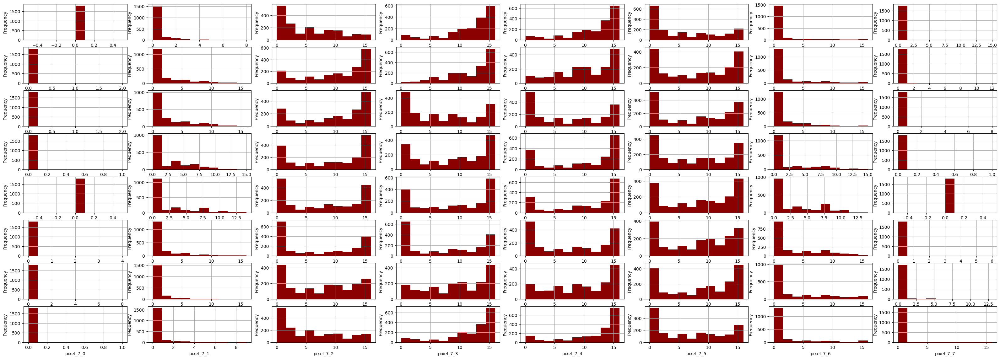

In [13]:
h =[]
nfeatures = len(features)
f = plt.figure(figsize=(40,1.75*8))
for nth_feat, feature in enumerate(features):
    plt.subplot(8, 8, nth_feat+1)
    colm = data[feature]
    hsub = h.append(colm.hist(color='darkRed'))
    plt.xlabel(feature)
    plt.ylabel("Frequency")
plt.show()
plt.close()

You start to see a pattern !

* Draw scatter plots of featurees to see correlations. Here there are many correlations, so kept half to speed things along.

In [15]:
halfNfeat = nfeatures/2
halfNfeat = int(halfNfeat) + 1 if (halfNfeat % int(halfNfeat) >0 ) else int(halfNfeat)
f = plt.figure(figsize=(2*nfeatures,2*nfeatures))
f, axes = plt.subplots(halfNfeat, halfNfeat, figsize=(2*nfeatures,2*nfeatures))
for nth_featVert, featureVert in enumerate(features[:halfNfeat]):
    for nth_feat, feature in enumerate(features[halfNfeat:]):
        axes[nth_featVert][nth_feat].scatter(x=frame[feature], y=frame[featureVert], c=frame["target"], s=10)
        axes[nth_featVert][nth_feat].set_xlabel(feature)
        axes[nth_featVert][nth_feat].set_ylabel(featureVert)
# plt.tight_layout()
plt.show()
plt.close()

<Figure size 12800x12800 with 0 Axes>